In [1]:
import numpy as np
import pandas as pd
%pip install -U scikit-learn
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt




Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [3]:
data = pd.read_csv('Data1.csv')

/var/folders/8d/b9k9gx950_58wp12cl76b35m0000gn/T/ipykernel_18102/4215948298.py:1: DtypeWarning: Columns (1,20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('Data1.csv')


In [4]:
print(data)

         match_id   season  start_date  \
0         1000851  2016/17  2016-11-03   
1         1000851  2016/17  2016-11-03   
2         1000851  2016/17  2016-11-03   
3         1000851  2016/17  2016-11-03   
4         1000851  2016/17  2016-11-03   
...           ...      ...         ...   
1639222   1166989     2019  2019-06-03   
1639223   1166989     2019  2019-06-03   
1639224   1166989     2019  2019-06-03   
1639225   1166989     2019  2019-06-03   
1639226   1166989     2019  2019-06-03   

                                                venue  innings  ball  \
0        Western Australia Cricket Association Ground        1   0.1   
1        Western Australia Cricket Association Ground        1   0.2   
2        Western Australia Cricket Association Ground        1   0.3   
3        Western Australia Cricket Association Ground        1   0.4   
4        Western Australia Cricket Association Ground        1   0.5   
...                                               ...      ... 

In [5]:
cricket_array = np.array(data)

In [6]:
#batting team 7, bowling team 8
#wides 14, no balls 15

In [7]:
batting_teams = np.unique(cricket_array[:, 6])
#len(batting_teams)
print(cricket_array[:, 6])

['South Africa' 'South Africa' 'South Africa' ... 'Derbyshire'
 'Derbyshire' 'Derbyshire']


In [8]:
bowling_teams = np.unique(cricket_array[:, 7])
#len(bowling_teams)
print(cricket_array[:, 7])

['Australia' 'Australia' 'Australia' ... 'Durham' 'Durham' 'Durham']


In [9]:
len(np.unique(cricket_array[:, 13]))

1638254

In [10]:
cricket_array[:, 13]

array([nan, nan, nan, ..., nan, nan, nan], dtype=object)

In [11]:
wides_test = []
for i in cricket_array[:, 13]:
    if i != 'NA':
        print(i)


nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
1.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan


In [12]:
np.min(cricket_array[:, 13], axis=0)

nan

In [15]:


file_path = 'Data1.csv'

df = pd.read_csv(file_path)

df['wides'] = pd.to_numeric(df['wides'], errors='coerce')
df['noballs'] = pd.to_numeric(df['noballs'], errors='coerce')

all_errors = df[(df['wides'].notna()) | (df['noballs'].notna())]

print(all_errors)


/var/folders/8d/b9k9gx950_58wp12cl76b35m0000gn/T/ipykernel_18102/843129789.py:5: DtypeWarning: Columns (1,20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


         match_id   season  start_date  \
111       1000851  2016/17  2016-11-03   
338       1000851  2016/17  2016-11-03   
394       1000851  2016/17  2016-11-03   
417       1000851  2016/17  2016-11-03   
455       1000851  2016/17  2016-11-03   
...           ...      ...         ...   
1638174   1166989     2019  2019-06-03   
1638459   1166989     2019  2019-06-03   
1638661   1166989     2019  2019-06-03   
1638777   1166989     2019  2019-06-03   
1638939   1166989     2019  2019-06-03   

                                                venue  innings  ball  \
111      Western Australia Cricket Association Ground        1  18.4   
338      Western Australia Cricket Association Ground        1  56.2   
394      Western Australia Cricket Association Ground        2   1.5   
417      Western Australia Cricket Association Ground        2   5.3   
455      Western Australia Cricket Association Ground        2  11.4   
...                                               ...      ... 

In [16]:
all_errors_array = np.array(all_errors)
wides = all_errors_array[:, 13]
noballs = all_errors_array[:, 14]

In [71]:
all_balls = np.array(df)
AUS_all_balls = all_balls[:, 6] == 'Australia'
AUS_divide = len(all_balls[AUS_all_balls])

NZ_all_balls = all_balls[:, 6] == 'New Zealand'
NZ_divide = len(all_balls[NZ_all_balls])

RSA_all_balls = all_balls[:, 6] == 'South Africa'
RSA_divide = len(all_balls[RSA_all_balls])

PAK_all_balls = all_balls[:, 6] == 'Pakistan'
PAK_divide = len(all_balls[PAK_all_balls])

SL_all_balls = all_balls[:, 6] == 'Sri Lanka'
SL_divide = len(all_balls[SL_all_balls])

IN_all_balls = all_balls[:, 6] == 'India'
IN_divide = len(all_balls[IN_all_balls])

ENG_all_balls = all_balls[:, 6] == 'England'
ENG_divide = len(all_balls[ENG_all_balls])

ZIM_all_balls = all_balls[:, 6] == 'Zimbabwe'
ZIM_divide = len(all_balls[ZIM_all_balls])

BA_all_balls = all_balls[:, 6] == 'Bangladesh'
BA_divide = len(all_balls[BA_all_balls])

WI_all_balls = all_balls[:, 6] == 'West Indies'
WI_divide = len(all_balls[WI_all_balls])


In [2]:
# pretend everything that says inning says ball

In [70]:
all_errors_array[:, 6]
aus_bool = all_errors_array[:, 6] == 'Australia'
print(len(all_errors_array[aus_bool])) # number of innings Australia batted in 

aus_batting_array = all_errors_array[aus_bool]
wides_aus_bat_count = 0
for i in aus_batting_array[:, 13]:
    if i > 0.1:
        wides_aus_bat_count += i
print(wides_aus_bat_count)

noballs_aus_bat_count = 0
for i in aus_batting_array[:, 14]:
    if i > 0.1:
        noballs_aus_bat_count += i
print(noballs_aus_bat_count)

Aus_bat_errors = ((wides_aus_bat_count + noballs_aus_bat_count) / AUS_divide)
print('There are ' + str(Aus_bat_errors) + ' errors per ball while Australia is batting')

# errors per game when Australia is batting

aus_bowl_bool = all_errors_array[:, 7] == 'Australia'
print(len(all_errors_array[aus_bowl_bool]))

aus_bowl_array = all_errors_array[aus_bowl_bool]
wides_aus_bowl_count = 0
for i in aus_bowl_array[:, 13]:
    if i > 0.1:
        wides_aus_bowl_count += i
print(wides_aus_bowl_count)

noballs_aus_bowl_count = 0
for i in aus_bowl_array[:, 14]:
    if i > 0.1:
        noballs_aus_bowl_count += i
print(noballs_aus_bowl_count)

Aus_bowl_errors = ((wides_aus_bowl_count + noballs_aus_bowl_count) / AUS_divide)
print('There are ' + str(Aus_bowl_errors) + ' errors per ball while Australia is bowling')
# errors per game when Australia is bowling

845
779.0
201.0
There are 0.016565526800655858 errors per ball while Australia is batting
785
882.0
103.0
There are 0.01665004479453676 errors per ball while Australia is bowling


In [72]:
NZ_bool = all_errors_array[:, 6] == 'New Zealand'
print(len(all_errors_array[NZ_bool])) # number of innings New Zealand batted in

NZ_batting_array = all_errors_array[NZ_bool]
wides_NZ_bat_count = 0
for i in NZ_batting_array[:, 13]:
    if i > 0.1:
        wides_NZ_bat_count += i
print(wides_NZ_bat_count)

noballs_NZ_bat_count = 0
for i in NZ_batting_array[:, 14]:
    if i > 0.1:
        noballs_NZ_bat_count += i
print(noballs_NZ_bat_count)

NZ_bat_errors = ((wides_NZ_bat_count + noballs_NZ_bat_count) / NZ_divide)
print('There are ' + str(NZ_bat_errors) + ' errors per inning while New Zealand is batting')

NZ_bowl_bool = all_errors_array[:, 7] == 'New Zealand'
print(len(all_errors_array[NZ_bowl_bool]))

NZ_bowl_array = all_errors_array[NZ_bowl_bool]
wides_NZ_bowl_count = 0
for i in NZ_bowl_array[:, 13]:
    if i > 0.1:
        wides_NZ_bowl_count += i
print(wides_NZ_bowl_count)

noballs_NZ_bowl_count = 0
for i in NZ_bowl_array[:, 14]:
    if i > 0.1:
        noballs_NZ_bowl_count += i
print(noballs_NZ_bowl_count)

NZ_bowl_errors = ((wides_NZ_bowl_count + noballs_NZ_bowl_count) / NZ_divide)
print('There are ' + str(NZ_bowl_errors) + ' errors per inning while New Zealand is bowling')

893
929.0
160.0
There are 0.02077966683839945 errors per inning while New Zealand is batting
1014
1134.0
83.0
There are 0.023222088652279274 errors per inning while New Zealand is bowling


In [73]:
RSA_bool = all_errors_array[:, 6] == 'South Africa'
print(len(all_errors_array[RSA_bool])) # number of innings South Africa batted in

RSA_batting_array = all_errors_array[RSA_bool]
wides_RSA_bat_count = 0
for i in RSA_batting_array[:, 13]:
    if i > 0.1:
        wides_RSA_bat_count += i
print(wides_RSA_bat_count)

noballs_RSA_bat_count = 0
for i in RSA_batting_array[:, 14]:
    if i > 0.1:
        noballs_RSA_bat_count += i
print(noballs_RSA_bat_count)

RSA_bat_errors = ((wides_RSA_bat_count + noballs_RSA_bat_count) / RSA_divide)
print('There are ' + str(RSA_bat_errors) + ' errors per inning while South Africa is batting')

RSA_bowl_bool = all_errors_array[:, 7] == 'South Africa'
print(len(all_errors_array[RSA_bowl_bool]))

RSA_bowl_array = all_errors_array[RSA_bowl_bool]
wides_RSA_bowl_count = 0
for i in RSA_bowl_array[:, 13]:
    if i > 0.1:
        wides_RSA_bowl_count += i
print(wides_RSA_bowl_count)

noballs_RSA_bowl_count = 0
for i in RSA_bowl_array[:, 14]:
    if i > 0.1:
        noballs_RSA_bowl_count += i
print(noballs_RSA_bowl_count)

RSA_bowl_errors = ((wides_RSA_bowl_count + noballs_RSA_bowl_count) / RSA_divide)
print('There are ' + str(RSA_bowl_errors) + ' errors per inning while South Africa is bowling')

684
735.0
96.0
There are 0.016539617459148538 errors per inning while South Africa is batting
914
977.0
156.0
There are 0.022550405031546684 errors per inning while South Africa is bowling


In [74]:
PAK_bool = all_errors_array[:, 6] == 'Pakistan'
print(len(all_errors_array[PAK_bool])) # number of innings Pakistan batted in

PAK_batting_array = all_errors_array[PAK_bool]
wides_PAK_bat_count = 0
for i in PAK_batting_array[:, 13]:
    if i > 0.1:
        wides_PAK_bat_count += i
print(wides_PAK_bat_count)

noballs_PAK_bat_count = 0
for i in PAK_batting_array[:, 14]:
    if i > 0.1:
        noballs_PAK_bat_count += i
print(noballs_PAK_bat_count)

PAK_bat_errors = ((wides_PAK_bat_count + noballs_PAK_bat_count) / PAK_divide)
print('There are ' + str(PAK_bat_errors) + ' errors per inning while Pakistan is batting')

PAK_bowl_bool = all_errors_array[:, 7] == 'Pakistan'
print(len(all_errors_array[PAK_bowl_bool]))

PAK_bowl_array = all_errors_array[PAK_bowl_bool]
wides_PAK_bowl_count = 0
for i in PAK_bowl_array[:, 13]:
    if i > 0.1:
        wides_PAK_bowl_count += i
print(wides_PAK_bowl_count)

noballs_PAK_bowl_count = 0
for i in PAK_bowl_array[:, 14]:
    if i > 0.1:
        noballs_PAK_bowl_count += i
print(noballs_PAK_bowl_count)

PAK_bowl_errors = ((wides_PAK_bowl_count + noballs_PAK_bowl_count) / PAK_divide)
print('There are ' + str(PAK_bowl_errors) + ' errors per inning while Pakistan is bowling')

1005
973.0
177.0
There are 0.02184028107492166 errors per inning while Pakistan is batting
792
740.0
164.0
There are 0.017168360079764505 errors per inning while Pakistan is bowling


In [75]:
SL_bool = all_errors_array[:, 6] == 'Sri Lanka'
print(len(all_errors_array[SL_bool])) # number of innings Sri Lanka batted in

SL_batting_array = all_errors_array[SL_bool]
wides_SL_bat_count = 0
for i in SL_batting_array[:, 13]:
    if i > 0.1:
        wides_SL_bat_count += i
print(wides_SL_bat_count)

noballs_SL_bat_count = 0
for i in SL_batting_array[:, 14]:
    if i > 0.1:
        noballs_SL_bat_count += i
print(noballs_SL_bat_count)

SL_bat_errors = ((wides_SL_bat_count + noballs_SL_bat_count) / SL_divide)
print('There are ' + str(SL_bat_errors) + ' errors per inning while Sri Lanka is batting')

SL_bowl_bool = all_errors_array[:, 7] == 'Sri Lanka'
print(len(all_errors_array[SL_bowl_bool]))

SL_bowl_array = all_errors_array[SL_bowl_bool]
wides_SL_bowl_count = 0
for i in SL_bowl_array[:, 13]:
    if i > 0.1:
        wides_SL_bowl_count += i
print(wides_SL_bowl_count)

noballs_SL_bowl_count = 0
for i in SL_bowl_array[:, 14]:
    if i > 0.1:
        noballs_SL_bowl_count += i
print(noballs_SL_bowl_count)

SL_bowl_errors = ((wides_SL_bowl_count + noballs_SL_bowl_count) / SL_divide)
print('There are ' + str(SL_bowl_errors) + ' errors per inning while Sri Lanka is bowling')

937
974.0
139.0
There are 0.0201087643859871 errors per inning while Sri Lanka is batting
885
877.0
162.0
There are 0.01877179352833836 errors per inning while Sri Lanka is bowling


In [76]:
IN_bool = all_errors_array[:, 6] == 'India'
print(len(all_errors_array[IN_bool])) # number of innings India batted in

IN_batting_array = all_errors_array[IN_bool]
wides_IN_bat_count = 0
for i in IN_batting_array[:, 13]:
    if i > 0.1:
        wides_IN_bat_count += i
print(wides_IN_bat_count)

noballs_IN_bat_count = 0
for i in IN_batting_array[:, 14]:
    if i > 0.1:
        noballs_IN_bat_count += i
print(noballs_IN_bat_count)

IN_bat_errors = ((wides_IN_bat_count + noballs_IN_bat_count) / IN_divide)
print('There are ' + str(IN_bat_errors) + ' errors per inning while India is batting')

IN_bowl_bool = all_errors_array[:, 7] == 'India'
print(len(all_errors_array[IN_bowl_bool]))

IN_bowl_array = all_errors_array[IN_bowl_bool]
wides_IN_bowl_count = 0
for i in IN_bowl_array[:, 13]:
    if i > 0.1:
        wides_IN_bowl_count += i
print(wides_IN_bowl_count)

noballs_IN_bowl_count = 0
for i in IN_bowl_array[:, 14]:
    if i > 0.1:
        noballs_IN_bowl_count += i
print(noballs_IN_bowl_count)

IN_bowl_errors = ((wides_IN_bowl_count + noballs_IN_bowl_count) / IN_divide)
print('There are ' + str(IN_bowl_errors) + ' errors per inning while India is bowling')

1114
1124.0
158.0
There are 0.017576571882969096 errors per inning while India is batting
993
977.0
155.0
There are 0.015520030711014834 errors per inning while India is bowling


In [77]:
ENG_bool = all_errors_array[:, 6] == 'England'
print(len(all_errors_array[ENG_bool])) # number of innings England batted in

ENG_batting_array = all_errors_array[ENG_bool]
wides_ENG_bat_count = 0
for i in ENG_batting_array[:, 13]:
    if i > 0.1:
        wides_ENG_bat_count += i
print(wides_ENG_bat_count)

noballs_ENG_bat_count = 0
for i in ENG_batting_array[:, 14]:
    if i > 0.1:
        noballs_ENG_bat_count += i
print(noballs_ENG_bat_count)

ENG_bat_errors = ((wides_ENG_bat_count + noballs_ENG_bat_count) / ENG_divide)
print('There are ' + str(ENG_bat_errors) + ' errors per inning while England is batting')

ENG_bowl_bool = all_errors_array[:, 7] == 'England'
print(len(all_errors_array[ENG_bowl_bool]))

ENG_bowl_array = all_errors_array[ENG_bowl_bool]
wides_ENG_bowl_count = 0
for i in ENG_bowl_array[:, 13]:
    if i > 0.1:
        wides_ENG_bowl_count += i
print(wides_ENG_bowl_count)

noballs_ENG_bowl_count = 0
for i in ENG_bowl_array[:, 14]:
    if i > 0.1:
        noballs_ENG_bowl_count += i
print(noballs_ENG_bowl_count)

ENG_bowl_errors = ((wides_ENG_bowl_count + noballs_ENG_bowl_count) / ENG_divide)
print('There are ' + str(ENG_bowl_errors) + ' errors per inning while England is bowling')

879
857.0
188.0
There are 0.01507914748704925 errors per inning while England is batting
878
884.0
107.0
There are 0.014299937951833307 errors per inning while England is bowling


In [78]:
ZIM_bool = all_errors_array[:, 6] == 'Zimbabwe'
print(len(all_errors_array[ZIM_bool])) # number of innings Zimbabwe batted in

ZIM_batting_array = all_errors_array[ZIM_bool]
wides_ZIM_bat_count = 0
for i in ZIM_batting_array[:, 13]:
    if i > 0.1:
        wides_ZIM_bat_count += i
print(wides_ZIM_bat_count)

noballs_ZIM_bat_count = 0
for i in ZIM_batting_array[:, 14]:
    if i > 0.1:
        noballs_ZIM_bat_count += i
print(noballs_ZIM_bat_count)

ZIM_bat_errors = ((wides_ZIM_bat_count + noballs_ZIM_bat_count) / ZIM_divide)
print('There are ' + str(ZIM_bat_errors) + ' errors per inning while Zimbabwe is batting')

ZIM_bowl_bool = all_errors_array[:, 7] == 'Zimbabwe'
print(len(all_errors_array[ZIM_bowl_bool]))

ZIM_bowl_array = all_errors_array[ZIM_bowl_bool]
wides_ZIM_bowl_count = 0
for i in ZIM_bowl_array[:, 13]:
    if i > 0.1:
        wides_ZIM_bowl_count += i
print(wides_ZIM_bowl_count)

noballs_ZIM_bowl_count = 0
for i in ZIM_bowl_array[:, 14]:
    if i > 0.1:
        noballs_ZIM_bowl_count += i
print(noballs_ZIM_bowl_count)

ZIM_bowl_errors = ((wides_ZIM_bowl_count + noballs_ZIM_bowl_count) / ZIM_divide)
print('There are ' + str(ZIM_bowl_errors) + ' errors per inning while Zimbabwe is bowling')

474
520.0
54.0
There are 0.02165220671444738 errors per inning while Zimbabwe is batting
620
658.0
77.0
There are 0.027725386646548472 errors per inning while Zimbabwe is bowling


In [79]:
BA_bool = all_errors_array[:, 6] == 'Bangladesh'
print(len(all_errors_array[BA_bool])) # number of innings Bangladesh batted in

BA_batting_array = all_errors_array[BA_bool]
wides_BA_bat_count = 0
for i in BA_batting_array[:, 13]:
    if i > 0.1:
        wides_BA_bat_count += i
print(wides_BA_bat_count)

noballs_BA_bat_count = 0
for i in BA_batting_array[:, 14]:
    if i > 0.1:
        noballs_BA_bat_count += i
print(noballs_BA_bat_count)

BA_bat_errors = ((wides_BA_bat_count + noballs_BA_bat_count) / BA_divide)
print('There are ' + str(BA_bat_errors) + ' errors per inning while Bangladesh is batting')

BA_bowl_bool = all_errors_array[:, 7] == 'Bangladesh'
print(len(all_errors_array[BA_bowl_bool]))

BA_bowl_array = all_errors_array[BA_bowl_bool]
wides_BA_bowl_count = 0
for i in BA_bowl_array[:, 13]:
    if i > 0.1:
        wides_BA_bowl_count += i
print(wides_BA_bowl_count)

noballs_BA_bowl_count = 0
for i in BA_bowl_array[:, 14]:
    if i > 0.1:
        noballs_BA_bowl_count += i
print(noballs_BA_bowl_count)

BA_bowl_errors = ((wides_BA_bowl_count + noballs_BA_bowl_count) / BA_divide)
print('There are ' + str(BA_bowl_errors) + ' errors per inning while Bangladesh is bowling')

909
935.0
122.0
There are 0.02493865609664024 errors per inning while Bangladesh is batting
546
630.0
60.0
There are 0.016279728199320498 errors per inning while Bangladesh is bowling


In [80]:
WI_bool = all_errors_array[:, 6] == 'West Indies'
print(len(all_errors_array[WI_bool])) # number of innings West Indies batted in

WI_batting_array = all_errors_array[WI_bool]
wides_WI_bat_count = 0
for i in WI_batting_array[:, 13]:
    if i > 0.1:
        wides_WI_bat_count += i
print(wides_WI_bat_count)

noballs_WI_bat_count = 0
for i in WI_batting_array[:, 14]:
    if i > 0.1:
        noballs_WI_bat_count += i
print(noballs_WI_bat_count)

WI_bat_errors = ((wides_WI_bat_count + noballs_WI_bat_count) / WI_divide)
print('There are ' + str(WI_bat_errors) + ' errors per inning while West Indies is batting')

WI_bowl_bool = all_errors_array[:, 7] == 'West Indies'
print(len(all_errors_array[WI_bowl_bool]))

WI_bowl_array = all_errors_array[WI_bowl_bool]
wides_WI_bowl_count = 0
for i in WI_bowl_array[:, 13]:
    if i > 0.1:
        wides_WI_bowl_count += i
print(wides_WI_bowl_count)

noballs_WI_bowl_count = 0
for i in WI_bowl_array[:, 14]:
    if i > 0.1:
        noballs_WI_bowl_count += i
print(noballs_WI_bowl_count)

WI_bowl_errors = ((wides_WI_bowl_count + noballs_WI_bowl_count) / WI_divide)
print('There are ' + str(WI_bowl_errors) + ' errors per inning while West Indies is bowling')

793
824.0
132.0
There are 0.018793001769215646 errors per inning while West Indies is batting
1031
844.0
336.0
There are 0.023196382936897974 errors per inning while West Indies is bowling


In [27]:
#Australia, New Zealand, South Africa, Pakistan, Sri Lanka, India, England, Zimbabwe, Bangladesh, West Indies

In [81]:
All_bat_errors = []
All_bat_errors.append(Aus_bat_errors)
All_bat_errors.append(NZ_bat_errors)
All_bat_errors.append(RSA_bat_errors)
All_bat_errors.append(PAK_bat_errors)
All_bat_errors.append(SL_bat_errors)
All_bat_errors.append(IN_bat_errors)
All_bat_errors.append(ENG_bat_errors)
All_bat_errors.append(ZIM_bat_errors)
All_bat_errors.append(BA_bat_errors)
All_bat_errors.append(WI_bat_errors)
print(All_bat_errors)

[0.016565526800655858, 0.02077966683839945, 0.016539617459148538, 0.02184028107492166, 0.0201087643859871, 0.017576571882969096, 0.01507914748704925, 0.02165220671444738, 0.02493865609664024, 0.018793001769215646]


In [82]:
All_bowl_errors = []
All_bowl_errors.append(Aus_bowl_errors)
All_bowl_errors.append(NZ_bowl_errors)
All_bowl_errors.append(RSA_bowl_errors)
All_bowl_errors.append(PAK_bowl_errors)
All_bowl_errors.append(SL_bowl_errors)
All_bowl_errors.append(IN_bowl_errors)
All_bowl_errors.append(ENG_bowl_errors)
All_bowl_errors.append(ZIM_bowl_errors)
All_bowl_errors.append(BA_bowl_errors)
All_bowl_errors.append(WI_bowl_errors)
print(All_bowl_errors)

[0.01665004479453676, 0.023222088652279274, 0.022550405031546684, 0.017168360079764505, 0.01877179352833836, 0.015520030711014834, 0.014299937951833307, 0.027725386646548472, 0.016279728199320498, 0.023196382936897974]


In [91]:
ABE = np.array(All_bat_errors)
print(np.sum(ABE) / 10)

ABOE = np.array(All_bowl_errors)
print(np.sum(ABOE) / 10)

0.01938734405094342
0.019538415853208063


In [83]:
#print(len(All_bat_errors))
#print(len(All_bat_errors))
#Countries = ['Australia', 'New Zealan', 'South Africa', 'Pakistan', 'Sri Lanka', 'India', 'England', 'Zimbabwe', 'Bangladesh', 'West Indies']
#print(len(Countries))

In [92]:
my_data1 = {

'Country1': ['Australia', 'New Zealand', 'South Africa', 'Pakistan', 'Sri Lanka', 'India', 'England', 'Zimbabwe', 'Bangladesh', 'West Indies', 'Top 10 Nations Averages'],
'Bat_Errors1': [Aus_bat_errors, NZ_bat_errors, RSA_bat_errors, PAK_bat_errors, SL_bat_errors, IN_bat_errors, ENG_bat_errors, ZIM_bat_errors, BA_bat_errors, WI_bat_errors, 0.01938734405094342],
'Bowl_Errors1': [Aus_bowl_errors, NZ_bowl_errors, RSA_bowl_errors, PAK_bowl_errors, SL_bowl_errors, IN_bowl_errors, ENG_bowl_errors, ZIM_bowl_errors, BA_bowl_errors, WI_bowl_errors, 0.019538415853208063]
}

my_df_1 = pd.DataFrame(my_data1)
print(my_df_1)

                   Country1  Bat_Errors1  Bowl_Errors1
0                 Australia     0.016566      0.016650
1               New Zealand     0.020780      0.023222
2              South Africa     0.016540      0.022550
3                  Pakistan     0.021840      0.017168
4                 Sri Lanka     0.020109      0.018772
5                     India     0.017577      0.015520
6                   England     0.015079      0.014300
7                  Zimbabwe     0.021652      0.027725
8                Bangladesh     0.024939      0.016280
9               West Indies     0.018793      0.023196
10  Top 10 Nations Averages     0.019387      0.019538


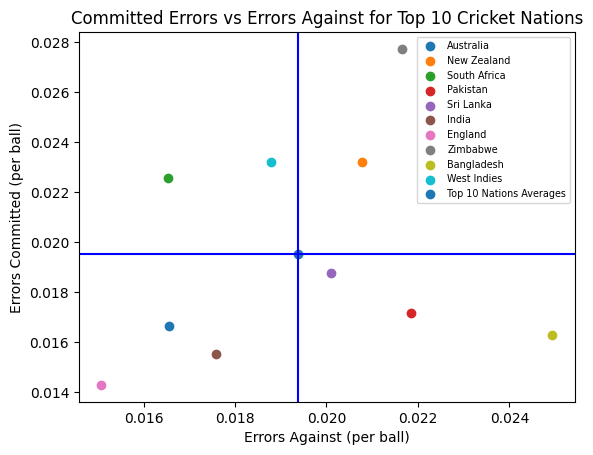

In [97]:
fig, ax = plt.subplots()

for index, row in my_df_1.iterrows():
    ax.scatter(row['Bat_Errors1'], row['Bowl_Errors1'], label=row['Country1'])

point_x = my_df_1.iloc[10, 1]
point_y = my_df_1.iloc[10, 2]

ax.axvline(x=point_x, color='blue', linestyle='-')
ax.axhline(y=point_y, color='blue', linestyle='-')

ax.set_xlabel('Errors Against (per ball)')
ax.set_ylabel('Errors Committed (per ball)')
ax.set_title('Committed Errors vs Errors Against for Top 10 Cricket Nations')
ax.legend(fontsize = 'x-small')

plt.show()

In [99]:
error_margins = []
Aus_EM = Aus_bat_errors - Aus_bowl_errors
NZ_EM = NZ_bat_errors - NZ_bowl_errors
RSA_EM = RSA_bat_errors - RSA_bowl_errors
PAK_EM = PAK_bat_errors - PAK_bowl_errors
SL_EM = SL_bat_errors - SL_bowl_errors
IN_EM = IN_bat_errors - IN_bowl_errors
ENG_EM = ENG_bat_errors - ENG_bowl_errors
ZIM_EM = ZIM_bat_errors - ZIM_bowl_errors
BA_EM = BA_bat_errors - BA_bowl_errors
WI_EM = WI_bat_errors - WI_bowl_errors
t10_avg = 1.1845266756944577 - 1.1872427348344576
error_margins.append(Aus_EM)
error_margins.append(NZ_EM)
error_margins.append(RSA_EM)
error_margins.append(PAK_EM)
error_margins.append(SL_EM)
error_margins.append(IN_EM)
error_margins.append(ENG_EM)
error_margins.append(ZIM_EM)
error_margins.append(BA_EM)
error_margins.append(WI_EM)
error_margins.append(t10_avg)


In [100]:
print(error_margins)
print(ENG_EM), print(WI_EM)
print(t10_avg)

[-8.451799388090042e-05, -0.002442421813879825, -0.006010787572398146, 0.004671920995157154, 0.00133697085764874, 0.002056541171954262, 0.0007792095352159422, -0.006073179932101092, 0.008658927897319743, -0.004403381167682328, -0.002716059139999949]
0.0007792095352159422
-0.004403381167682328
-0.002716059139999949


Text(0.5, 1.0, 'Error Margins (per ball)')

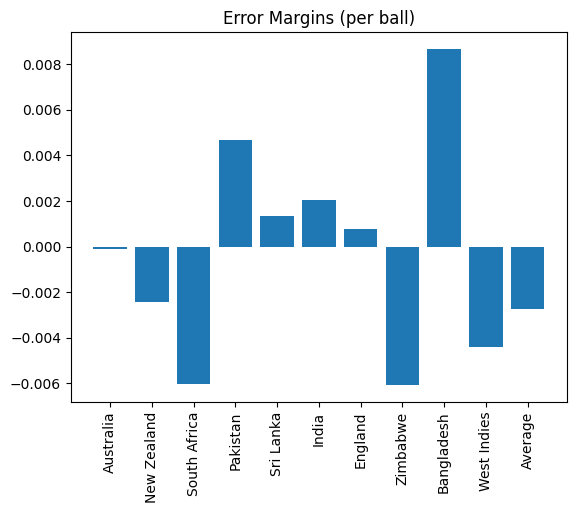

In [102]:
x_ticks = np.arange(len(error_margins))
bar_names = ['Australia', 'New Zealand', 'South Africa', 'Pakistan', 'Sri Lanka', 'India', 'England', 'Zimbabwe', 'Bangladesh', 'West Indies', 'Average']
plt.bar(x_ticks, error_margins)
plt.xticks(x_ticks, bar_names, rotation='vertical')
plt.title('Error Margins (per ball)')

In [104]:
all_errors_array = np.array(all_errors)
wides = all_errors_array[:, 13]
noballs = all_errors_array[:, 14]

total_innings = (len(all_balls))
print(total_innings)

all_wides = 0
for i in all_errors_array[:, 13]:
    if i > 0.1:
        all_wides += i
print(all_wides)

all_noballs = 0
for i in all_errors_array[:, 14]:
    if i > 0.1:
        all_noballs += i
print(all_noballs)

Grand_Cricket_Error_Avg = (all_wides + all_noballs) / total_innings
print('There are ' + str(Grand_Cricket_Error_Avg) + ' errors per ball on average in cricket')





1639227
28941.0
9625.0
There are 0.023526942882224365 errors per ball on average in cricket


In [105]:
average_top10_bat_errors = my_df_1['Bat_Errors1'].mean()
print('The top 10 countries have ' + str(average_top10_bat_errors) + ' errors against them per inning')

The top 10 countries have 0.01938734405094342 errors against them per inning


avg_bat_t10 = '1.1845266756944577'
avg_bowl_t10 = '1.1872427348344576'

In [107]:
average_top10_bowl_errors = my_df_1['Bowl_Errors1'].mean()
print('The top 10 countries commit ' + str(average_top10_bowl_errors) + ' errors per ball')

The top 10 countries commit 0.019538415853208063 errors per ball


In [1]:
# just pretend everything that says New Zealand actually says Bangaldesh. Sorry
# and that everything that says inning says ball

In [109]:
NZ_Batting_array = all_balls[BA_all_balls]
NZ_AUS_bool = NZ_Batting_array[:, 7] == 'Australia'
NZ_vs_AUS = NZ_Batting_array[NZ_AUS_bool]

wides_NZ_vs_AUS_bowl_count = 0
for i in NZ_vs_AUS[:, 13]:
    if i > 0.1:
        wides_NZ_vs_AUS_bowl_count += i
print(wides_NZ_vs_AUS_bowl_count)

noballs_NZ_vs_AUS_bowl_count = 0
for i in NZ_vs_AUS[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_AUS_bowl_count += i
print(noballs_NZ_vs_AUS_bowl_count)

print(len(NZ_vs_AUS))

print('Australia committed ' + str((wides_NZ_vs_AUS_bowl_count + noballs_NZ_vs_AUS_bowl_count) / len(NZ_vs_AUS)) + ' errors per inning against New Zealand')
AUS_errors_NZ = (wides_NZ_vs_AUS_bowl_count + noballs_NZ_vs_AUS_bowl_count) / len(NZ_vs_AUS)

14.0
2.0
2637
Australia committed 0.006067500948047023 errors per inning against New Zealand


In [110]:
np.unique(NZ_Batting_array[:, 7])


array(['Afghanistan', 'Australia', 'England', 'India', 'Ireland',
       'Malaysia', 'Netherlands', 'New Zealand', 'Pakistan',
       'Papua New Guinea', 'Scotland', 'South Africa', 'Sri Lanka',
       'Thailand', 'United Arab Emirates', 'West Indies', 'Zimbabwe'],
      dtype=object)

In [119]:
NZ_BA_bool = NZ_Batting_array[:, 7] == 'New Zealand'
NZ_vs_BA = NZ_Batting_array[NZ_BA_bool]

wides_NZ_vs_BA_bowl_count = 0
for i in NZ_vs_BA[:, 13]:
    if i > 0.1:
        wides_NZ_vs_BA_bowl_count += i
print(wides_NZ_vs_BA_bowl_count)

noballs_NZ_vs_BA_bowl_count = 0
for i in NZ_vs_BA[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_BA_bowl_count += i
print(noballs_NZ_vs_BA_bowl_count)

print(len(NZ_vs_BA))

print('Bangladesh committed ' + str((wides_NZ_vs_BA_bowl_count + noballs_NZ_vs_BA_bowl_count) / len(NZ_vs_BA)) + ' errors per inning against New Zealand')
BA_errors_NZ = (wides_NZ_vs_BA_bowl_count + noballs_NZ_vs_BA_bowl_count) / len(NZ_vs_BA)

191.0
7.0
7140
Bangladesh committed 0.02773109243697479 errors per inning against New Zealand


In [112]:
NZ_ENG_bool = NZ_Batting_array[:, 7] == 'England'
NZ_vs_ENG = NZ_Batting_array[NZ_ENG_bool]

wides_NZ_vs_ENG_bowl_count = 0
for i in NZ_vs_ENG[:, 13]:
    if i > 0.1:
        wides_NZ_vs_ENG_bowl_count += i
print(wides_NZ_vs_ENG_bowl_count)

noballs_NZ_vs_ENG_bowl_count = 0
for i in NZ_vs_ENG[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_ENG_bowl_count += i
print(noballs_NZ_vs_ENG_bowl_count)

print(len(NZ_vs_ENG))

print('England committed ' + str((wides_NZ_vs_ENG_bowl_count + noballs_NZ_vs_ENG_bowl_count) / len(NZ_vs_ENG)) + ' errors per inning against New Zealand')
ENG_errors_NZ = (wides_NZ_vs_ENG_bowl_count + noballs_NZ_vs_ENG_bowl_count) / len(NZ_vs_ENG)

50.0
3.0
3438
England committed 0.015415939499709133 errors per inning against New Zealand


In [113]:
NZ_IN_bool = NZ_Batting_array[:, 7] == 'India'
NZ_vs_IN = NZ_Batting_array[NZ_IN_bool]

wides_NZ_vs_IN_bowl_count = 0
for i in NZ_vs_IN[:, 13]:
    if i > 0.1:
        wides_NZ_vs_IN_bowl_count += i
print(wides_NZ_vs_IN_bowl_count)

noballs_NZ_vs_IN_bowl_count = 0
for i in NZ_vs_IN[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_IN_bowl_count += i
print(noballs_NZ_vs_IN_bowl_count)

print(len(NZ_vs_IN))

print('India committed ' + str((wides_NZ_vs_IN_bowl_count + noballs_NZ_vs_IN_bowl_count) / len(NZ_vs_IN)) + ' errors per inning against New Zealand')
IN_errors_NZ = (wides_NZ_vs_IN_bowl_count + noballs_NZ_vs_IN_bowl_count) / len(NZ_vs_IN)

48.0
9.0
3500
India committed 0.016285714285714285 errors per inning against New Zealand


In [114]:
NZ_PAK_bool = NZ_Batting_array[:, 7] == 'Pakistan'
NZ_vs_PAK = NZ_Batting_array[NZ_PAK_bool]

wides_NZ_vs_PAK_bowl_count = 0
for i in NZ_vs_PAK[:, 13]:
    if i > 0.1:
        wides_NZ_vs_PAK_bowl_count += i
print(wides_NZ_vs_PAK_bowl_count)

noballs_NZ_vs_PAK_bowl_count = 0
for i in NZ_vs_PAK[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_PAK_bowl_count += i
print(noballs_NZ_vs_PAK_bowl_count)

print(len(NZ_vs_PAK))

print('Pakistan committed ' + str((wides_NZ_vs_PAK_bowl_count + noballs_NZ_vs_PAK_bowl_count) / len(NZ_vs_PAK)) + ' errors per inning against New Zealand')
PAK_errors_NZ = (wides_NZ_vs_PAK_bowl_count + noballs_NZ_vs_PAK_bowl_count) / len(NZ_vs_PAK)

22.0
0
984
Pakistan committed 0.022357723577235773 errors per inning against New Zealand


In [115]:
NZ_RSA_bool = NZ_Batting_array[:, 7] == 'South Africa'
NZ_vs_RSA = NZ_Batting_array[NZ_RSA_bool]

wides_NZ_vs_RSA_bowl_count = 0
for i in NZ_vs_RSA[:, 13]:
    if i > 0.1:
        wides_NZ_vs_RSA_bowl_count += i
print(wides_NZ_vs_RSA_bowl_count)

noballs_NZ_vs_RSA_bowl_count = 0
for i in NZ_vs_RSA[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_RSA_bowl_count += i
print(noballs_NZ_vs_RSA_bowl_count)

print(len(NZ_vs_RSA))

print('South Africa committed ' + str((wides_NZ_vs_RSA_bowl_count + noballs_NZ_vs_RSA_bowl_count) / len(NZ_vs_RSA)) + ' errors per inning against New Zealand')
RSA_errors_NZ = (wides_NZ_vs_RSA_bowl_count + noballs_NZ_vs_RSA_bowl_count) / len(NZ_vs_RSA)

print(RSA_errors_NZ)


127.0
18.0
5080
South Africa committed 0.028543307086614175 errors per inning against New Zealand
0.028543307086614175


In [116]:
NZ_SL_bool = NZ_Batting_array[:, 7] == 'Sri Lanka'
NZ_vs_SL = NZ_Batting_array[NZ_SL_bool]

wides_NZ_vs_SL_bowl_count = 0
for i in NZ_vs_SL[:, 13]:
    if i > 0.1:
        wides_NZ_vs_SL_bowl_count += i
print(wides_NZ_vs_SL_bowl_count)

noballs_NZ_vs_SL_bowl_count = 0
for i in NZ_vs_SL[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_SL_bowl_count += i
print(noballs_NZ_vs_SL_bowl_count)

print(len(NZ_vs_SL))

print('Sri Lanka committed ' + str((wides_NZ_vs_SL_bowl_count + noballs_NZ_vs_SL_bowl_count) / len(NZ_vs_SL)) + ' errors per inning against New Zealand')
SL_errors_NZ = (wides_NZ_vs_SL_bowl_count + noballs_NZ_vs_SL_bowl_count) / len(NZ_vs_SL)

140.0
19.0
6565
Sri Lanka committed 0.02421934501142422 errors per inning against New Zealand


In [117]:
NZ_WI_bool = NZ_Batting_array[:, 7] == 'West Indies'
NZ_vs_WI = NZ_Batting_array[NZ_WI_bool]

wides_NZ_vs_WI_bowl_count = 0
for i in NZ_vs_WI[:, 13]:
    if i > 0.1:
        wides_NZ_vs_WI_bowl_count += i
print(wides_NZ_vs_WI_bowl_count)

noballs_NZ_vs_WI_bowl_count = 0
for i in NZ_vs_WI[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_WI_bowl_count += i
print(noballs_NZ_vs_WI_bowl_count)

print(len(NZ_vs_WI))

print('West Indies committed ' + str((wides_NZ_vs_WI_bowl_count + noballs_NZ_vs_WI_bowl_count) / len(NZ_vs_WI)) + ' errors per inning against New Zealand')
WI_errors_NZ = (wides_NZ_vs_WI_bowl_count + noballs_NZ_vs_WI_bowl_count) / len(NZ_vs_WI)

119.0
40.0
5393
West Indies committed 0.029482662710921564 errors per inning against New Zealand


In [120]:
NZ_ZIM_bool = NZ_Batting_array[:, 7] == 'Zimbabwe'
NZ_vs_ZIM = NZ_Batting_array[NZ_ZIM_bool]

wides_NZ_vs_ZIM_bowl_count = 0
for i in NZ_vs_ZIM[:, 13]:
    if i > 0.1:
        wides_NZ_vs_ZIM_bowl_count += i
print(wides_NZ_vs_ZIM_bowl_count)

noballs_NZ_vs_ZIM_bowl_count = 0
for i in NZ_vs_ZIM[:, 14]:
    if i > 0.1:
        noballs_NZ_vs_ZIM_bowl_count += i
print(noballs_NZ_vs_ZIM_bowl_count)

print(len(NZ_vs_ZIM))

print('Zimbabwe committed ' + str((wides_NZ_vs_ZIM_bowl_count + noballs_NZ_vs_ZIM_bowl_count) / len(NZ_vs_ZIM)) + ' errors per inning against New Zealand')
ZIM_errors_NZ = (wides_NZ_vs_ZIM_bowl_count + noballs_NZ_vs_ZIM_bowl_count) / len(NZ_vs_ZIM)

70.0
13.0
3323
Zimbabwe committed 0.02497743003310262 errors per inning against New Zealand


In [121]:
NZ_minus_errors = []
AUS_NZ_diff = AUS_errors_NZ - Aus_bowl_errors
RSA_NZ_diff = RSA_errors_NZ - RSA_bowl_errors
PAK_NZ_diff = PAK_errors_NZ - PAK_bowl_errors
SL_NZ_diff = SL_errors_NZ - SL_bowl_errors
IN_NZ_diff = IN_errors_NZ - IN_bowl_errors
ENG_NZ_diff = ENG_errors_NZ - ENG_bowl_errors
ZIM_NZ_diff = ZIM_errors_NZ - ZIM_bowl_errors
BA_NZ_diff = BA_errors_NZ - BA_bowl_errors
WI_NZ_diff = WI_errors_NZ - WI_bowl_errors
NZ_minus_errors.append(AUS_NZ_diff)
NZ_minus_errors.append(RSA_NZ_diff)
NZ_minus_errors.append(PAK_NZ_diff)
NZ_minus_errors.append(SL_NZ_diff)
NZ_minus_errors.append(IN_NZ_diff)
NZ_minus_errors.append(ENG_NZ_diff)
NZ_minus_errors.append(ZIM_NZ_diff)
NZ_minus_errors.append(BA_NZ_diff)
NZ_minus_errors.append(WI_NZ_diff)

print(NZ_minus_errors)



[-0.010582543846489736, 0.00599290205506749, 0.005189363497471268, 0.005447551483085858, 0.0007656835746994509, 0.0011160015478758264, -0.0027479566134458525, 0.01145136423765429, 0.0062862797740235905]


In [122]:
print(RSA_bowl_errors)
print(RSA_errors_NZ)

0.022550405031546684
0.028543307086614175


Text(0.5, 1.0, 'Errors per ball above average against Bangladesh')

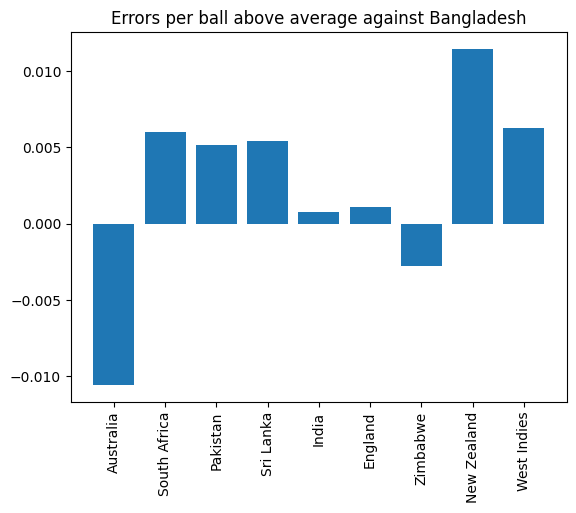

In [146]:
NZ_bar_names = ['Australia', 'South Africa', 'Pakistan', 'Sri Lanka', 'India', 'England', 'Zimbabwe', 'New Zealand', 'West Indies']
x_ticks_NZ = np.arange(len(NZ_minus_errors))

plt.bar(x_ticks_NZ, NZ_minus_errors)
plt.xticks(x_ticks_NZ, NZ_bar_names, rotation='vertical')
plt.title('Errors per ball above average against Bangladesh')

In [132]:
np.unique(all_errors_array[:, 4])
inning = all_errors_array[:, 4]
_wides = all_errors_array[:, 13]
_noballs = all_errors_array[:, 14]

afirst_wides_1 = 0
afirst_noballs_1 = 0
asecond_wides = 0
asecond_noballs = 0
athird_wides = 0
athird_noballs = 0
afourth_wides = 0
afourth_noballs = 0

first_inning_bool = all_balls[:, 4] == 1
second_inning_bool = all_balls[:, 4] == 2
third_inning_bool = all_balls[:, 4] == 3
fourth_inning_bool = all_balls[:, 4] == 4

first_innings = all_balls[first_inning_bool]
second_innings = all_balls[second_inning_bool]
third_innings = all_balls[third_inning_bool]
fourth_innings = all_balls[fourth_inning_bool]


In [133]:
for i in first_innings[:, 13]:
    if i > 0.1:
        afirst_wides_1 += i
for i in first_innings[:, 14]:
    if i > 0.1:
        afirst_noballs_1 += i

print(afirst_wides_1)
print(afirst_noballs_1)
   

15004.0
3907.0


In [134]:
for i in second_innings[:, 13]:
    if i > 0.1:
        asecond_wides += i
for i in second_innings[:, 14]:
    if i > 0.1:
        asecond_noballs += i

print(asecond_wides)
print(asecond_noballs)

13190.0
3585.0


In [135]:
for i in third_innings[:, 13]:
    if i > 0.1:
        athird_wides += i
for i in third_innings[:, 14]:
    if i > 0.1:
        athird_noballs += i

print(athird_wides)
print(athird_noballs)

480.0
1416.0


In [136]:
for i in fourth_innings[:, 13]:
    if i > 0.1:
        afourth_wides += i
for i in fourth_innings[:, 14]:
    if i > 0.1:
        afourth_noballs += i

print(afourth_wides)
print(afourth_noballs)

267.0
717.0


In [145]:
len(first_innings), len(second_innings), len(third_innings), len(fourth_innings)

(704697, 622118, 201398, 111014)

In [138]:
errors_per_first = ((afirst_wides_1 + afirst_noballs_1) / len(first_innings))
errors_per_second = ((asecond_wides + asecond_noballs) / len(second_innings))
errors_per_third = ((athird_wides + athird_noballs) / len(third_innings))
errors_per_fourth = ((afourth_wides + afourth_noballs) / len(fourth_innings))


In [139]:
errors_per_inning = [errors_per_first, errors_per_second, errors_per_third, errors_per_fourth]
line_ticks = np.arange(len(errors_per_inning))
line_labels = ['First Inning', 'Second Inning', 'Third Inning', 'Fourth Inning']

Text(0.5, 1.0, 'Errors Per Ball for Each Inning in All Matches')

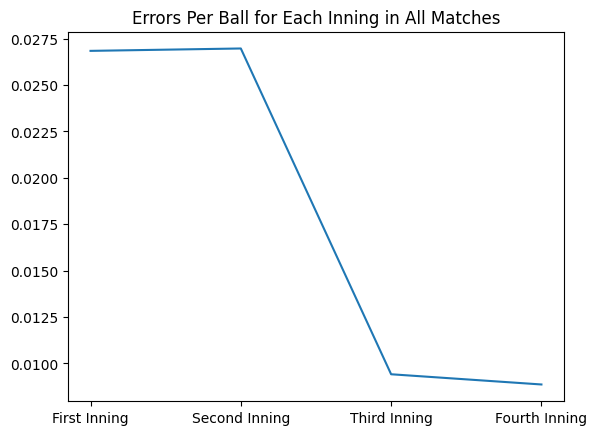

In [141]:
plt.plot(line_ticks, errors_per_inning)
plt.xticks(line_ticks, line_labels)
plt.title('Errors Per Ball for Each Inning in All Matches')